

---
title: "Visualizing Arrays using Excel"
execute: 
  enabled: false
  freeze: true
date: "6/23/2024"
date-modified: "6/23/2024"
categories: [array, numpy, tensor, excel]
---


>Visualizing simple operations across arrays

In [5]:
import numpy as np
import torch
from torch import tensor


In deep learning world, we are always working with arrays and tensors. They are data structure in which we store data for our model to train on. Both are multi-dimensional data structure and have similar functionality, but tensors had more restrictions than arrays.

Tensor must:
- use a single basic numerical type for all components in the array.
- can not be jagged. It is always regularly shaped multi-dimensional rectangular structure.

I always had trouble trying to understand what exactly happen when we perform operations on any data structure that has higher dimension than a list (dimension of 1). 

So, let's use Excel to visualize some basic operations on arrays (or tensors)! Say we have 2 tensors, a and b. Both of dimension of 3.

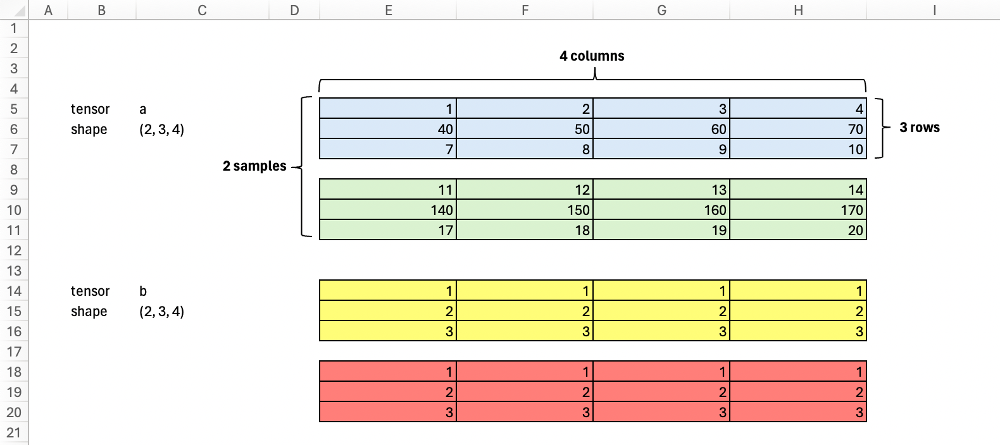

In [11]:
a = tensor([[[1,2,3,4],
            [40,50,60,70],
            [7,8,9,10]], 
           
           [[11,12,13,14],
           [140,150,160,170],
           [17,18,19,20]]])


b = tensor([[[1,1,1,1],
            [2,2,2,2],
            [3,3,3,3]],
           
           [[1,1,1,1],
           [2,2,2,2],
           [3,3,3,3]]])

print('a shape:\t', a.shape)
print('b shape:\t', b.shape)

a shape:	 torch.Size([2, 3, 4])
b shape:	 torch.Size([2, 3, 4])


# Element wise operation

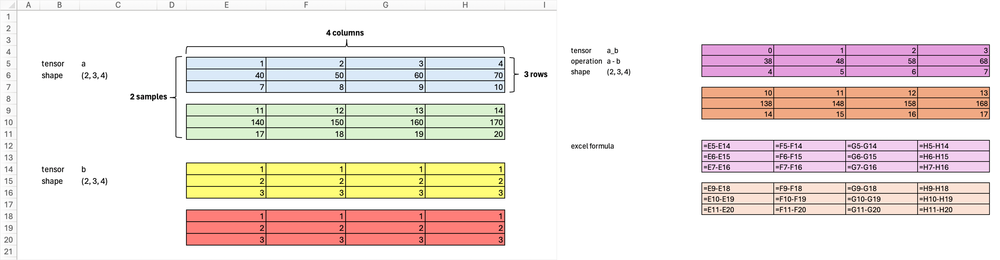

If we subtract tensor a - tensor b, we are doing elementwise operation because both tensors a and b are of the same shape.


In [12]:
a_b = a - b
print('a_b shape:\t', a_b.shape)
a_b

a_b shape:	 torch.Size([2, 3, 4])


tensor([[[  0,   1,   2,   3],
         [ 38,  48,  58,  68],
         [  4,   5,   6,   7]],

        [[ 10,  11,  12,  13],
         [138, 148, 158, 168],
         [ 14,  15,  16,  17]]])

# Sum across tensor

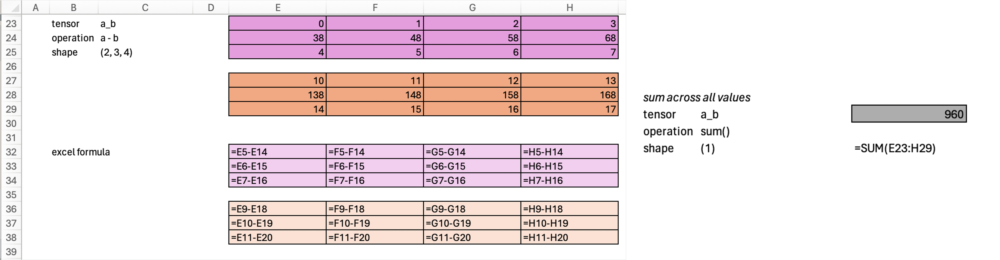

If we sum across the whole tensor, we will get a scalar value (dimension 0). Scalar value is another name for *a number*.

In [46]:
print(a_b.sum().shape)
a_b.sum()

torch.Size([])


tensor(960)

# Sum across axis

Now, let's do sum operation across axis. Axis could be sample, row or column. Notice that our tensor `a_b` had shape of (2,3,4). This means it is made up of 2 samples (E23:H25 cells is a sample, E27:H29 cells is the other sample), each sample has 3 rows and 4 columns. So from shape information, we know (total samples, total rows in each sample, total columns in each sample).

In code, the shape information is often represented as tuple data structure. Which means we can also do negative indexing, ie:
- shape at index -2 == column information
- shape at index -1 == row information
- shape at index 0 == sample information


Sum across any axis would collapse the specified axis. What do I mean by this?

Originally, our `a_b` tensor is of shape (2, 3, 4). If we *add all rows*, keeping everything else the same. Our resulting shape would be (2, **3**, 4) --> (2, **1**, 4)



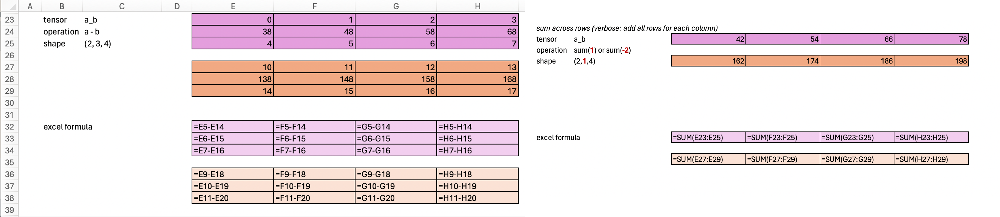

In [28]:
print(a_b.sum(-2, keepdim=True).shape)
a_b.sum(-2, keepdim=True)

torch.Size([2, 1, 4])


tensor([[[ 42,  54,  66,  78]],

        [[162, 174, 186, 198]]])

Yup, this below is the same. The only difference here is that we use index here. Above, we use negative indexing style. The same thing, just different way of writing, don't let it confuse you.

In [29]:

print(a_b.sum(1, keepdim=True).shape)
a_b.sum(1, keepdim=True)

torch.Size([2, 1, 4])


tensor([[[ 42,  54,  66,  78]],

        [[162, 174, 186, 198]]])

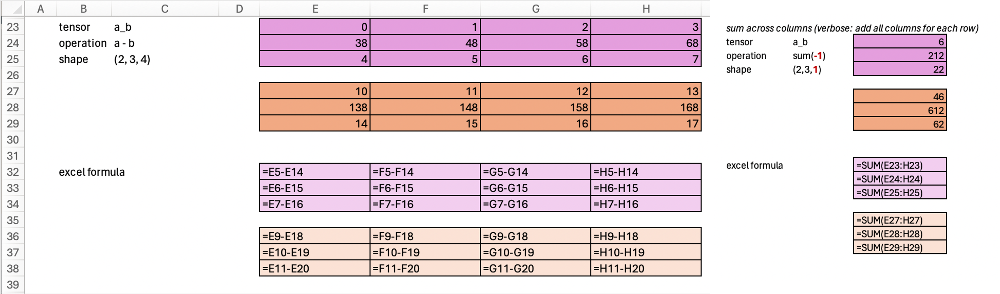

Similarly, if we *add all columns*, keeping everything the same. Then our resulting shape would be (2, 3, **4**) --> (2, 3, **1**)

In [24]:
print(a_b.sum(-1, keepdim=True).shape)
a_b.sum(-1, keepdim=True)

torch.Size([2, 3, 1])


tensor([[[  6],
         [212],
         [ 22]],

        [[ 46],
         [612],
         [ 62]]])

In [30]:
print(a_b.sum(2, keepdim=True).shape)
a_b.sum(2, keepdim=True)

torch.Size([2, 3, 1])


tensor([[[  6],
         [212],
         [ 22]],

        [[ 46],
         [612],
         [ 62]]])

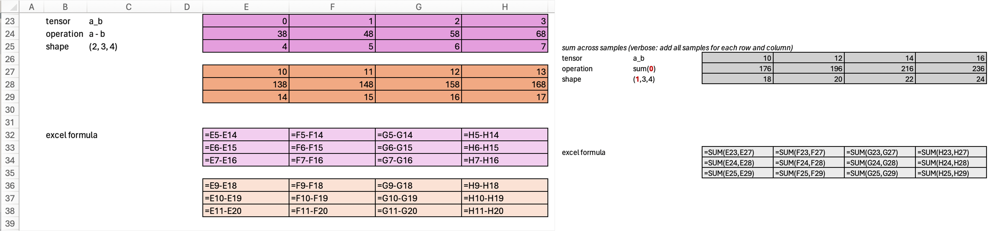

Now, if we *add all samples*, keeping everything else the same. Our result would be from shape (**2**, 3, 4) --> (**1**, 3, 4).

In [32]:
print(a_b.sum(0, keepdim=True).shape)
a_b.sum(0, keepdim=True)

torch.Size([1, 3, 4])


tensor([[[ 10,  12,  14,  16],
         [176, 196, 216, 236],
         [ 18,  20,  22,  24]]])

In [33]:
print(a_b.sum(-3, keepdim=True).shape)
a_b.sum(-3, keepdim=True)

torch.Size([1, 3, 4])


tensor([[[ 10,  12,  14,  16],
         [176, 196, 216, 236],
         [ 18,  20,  22,  24]]])

# Sum across multiple axis

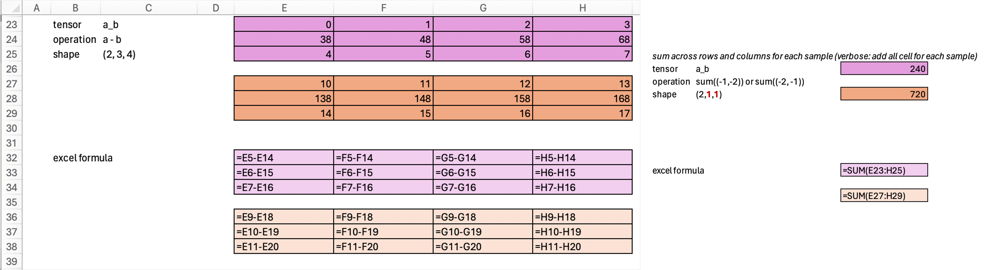

We can also do sum across multiple axis. Remember that our original tensor is of shape (2, 3, 4), if we do sum operation across both rows and columns, then we would be *collapsing both of these axis*, keeping everything else the same. So the resulting tensor would be from shape (2, **3, 4**) --> (2, **1, 1**).



In [44]:
print(a_b.sum((-1,-2), keepdim=True).shape)
a_b.sum((-1,-2), keepdim=True)

torch.Size([2, 1, 1])


tensor([[[240]],

        [[720]]])

Also notice that the order in which we specify the axes does not matter. `.sum((-1, -2))` is the same as `.sum((-2, -1))`.

In [43]:
print(a_b.sum((-2,-1), keepdim=True).shape)
a_b.sum((-2,-1), keepdim=True)

torch.Size([2, 1, 1])


tensor([[[240]],

        [[720]]])

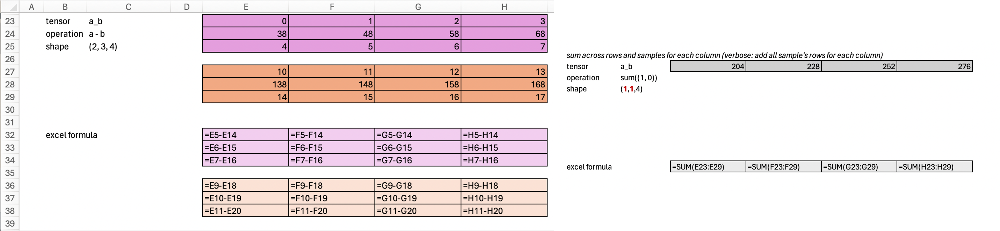

Now we *sum all samples and rows*, keeping everything else the same. The resulting tensor would be from (**2, 3,** 4) --> (**1, 1,** 4).


In [40]:
print(a_b.sum((0,1), keepdim=True).shape)
a_b.sum((0,1), keepdim=True)

torch.Size([1, 1, 4])


tensor([[[204, 228, 252, 276]]])

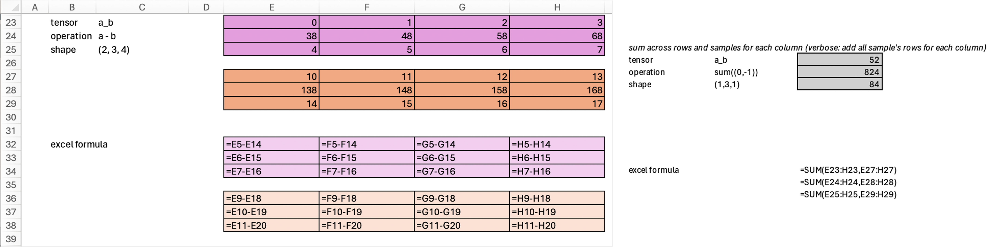

Lastly, if we sum all samples and columns, then the resulting tensor would be from (**2**, 3, **4**) --> (**1**, 3, **1**). 

Notice that for resulting value 52, our excel formula is E23:H23 + E27:H27 ≈ we add everything from first row in sample 1, plus everything from first row in sample 2.


In [39]:
print(a_b.sum((0,-1), keepdim=True).shape)
a_b.sum((0,-1), keepdim=True)

torch.Size([1, 3, 1])


tensor([[[ 52],
         [824],
         [ 84]]])

Hopefully, now it is easy to notice that any axis we choose to perform operations on would be *collapsed* to 1. Which means, when we collapsed all axes, it is equivalent to sum across everything in the tensor. ie in code, this is:

In [56]:
print(a_b.sum((0,1,2)).shape)
a_b.sum((0,1,2))

torch.Size([])


tensor(960)

which is the same as:


In [57]:
print(a_b.sum().shape)
a_b.sum()

torch.Size([])


tensor(960)

All above operations can be also performed using numpy arrays. For example, the equivalent summing across samples and rows in numpy is:

In [54]:
print(np.array(a_b).sum((0,-1), keepdims=True).shape)
np.array(a_b).sum((0,-1), keepdims=True)

(1, 3, 1)


array([[[ 52],
        [824],
        [ 84]]])

Visualizing these tensors and formulas on excel makes it easier to for me to see what happen in the background. Hopefully, it is helpful to you too.